# Notes

Select GPU as runtime

This is a continuation of our project Cap Recognizer

The goal of this project is to classify 13 different types of caps / headwears commonly worn around the world. The types are following: <br/>
- balaclava cap
- baseball cap
- beanie cap
- boater hat
- bowler hat
- bucket hat
- cowboy hat
- flat cap
- kepi cap
- taqiyah cap
- top hat
- turban cap
- visor cap

# Importing Libraries and Setting up Project Directory

In [ ]:
!pip install -Uqq fastai

In [ ]:
from fastai import *
from fastai.vision.all import *
from fastai.vision.widgets import *

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cd /content/drive/MyDrive/2025_ALL_Master_Course_Works/ALL_DL_CV/CV-Project-1_Cap-Recognizer

/content/drive/MyDrive/2025_ALL_Master_Course_Works/ALL_DL_CV/CV-Project-1_Cap-Recognizer


# File Checking

In [ ]:
# showing total file counts for each category
# Path to main data folder
data_folder = '/content/drive/MyDrive/2025_ALL_Master_Course_Works/ALL_DL_CV/CV-Project-1_Cap-Recognizer/dataset'

# Dictionary to store file counts
file_counts = {}

# Loop through each item in the data folder
for subfolder in os.listdir(data_folder):
    subfolder_path = os.path.join(data_folder, subfolder)

    # Check if it's a directory
    if os.path.isdir(subfolder_path):
        # Count only files (not subdirectories)
        files = [f for f in os.listdir(subfolder_path) if os.path.isfile(os.path.join(subfolder_path, f))]
        file_counts[subfolder] = len(files)

# Display the results
for category, count in file_counts.items():
    print(f"{category}: {count} files")


balaclava cap: 100 files
baseball cap: 100 files
beanie cap: 100 files
boater hat: 100 files
bowler hat: 100 files
bucket hat: 100 files
cowboy hat: 100 files
flat cap: 100 files
kepi cap: 100 files
taqiyah cap: 100 files
top hat: 100 files
turban cap: 100 files
visor cap: 100 files


NB: I checked all the folders and deleted irrelevant data manually from drive

# Loading data to Data Loader and Data Augmentation

In [ ]:
data_path = "dataset"
dblock = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,                        # get_image_files returns a list of all images in that path recursively by default
    splitter=RandomSplitter(valid_pct=0.1, seed=42),  # getting 90-10 train-validation split
    get_y=parent_label,                               # taking the folder name as labels
    item_tfms=Resize(128))                            # resizing to get the image of same shape

In [ ]:
# Data Augmentation

bs = 32 # batch size
version = 1

dblock = dblock.new(item_tfms=RandomResizedCrop(224, min_scale=0.5), batch_tfms=aug_transforms())
dls = dblock.dataloaders(data_path, bs = bs)
# saving augmented data
# torch.save(dls, f"data_loaders/cap_dataloader_v{version}.pkl")

In [ ]:
# to load data from existing file
# dls = torch.load(f"data_loaders/cap_dataloader_v{version}.pkl")

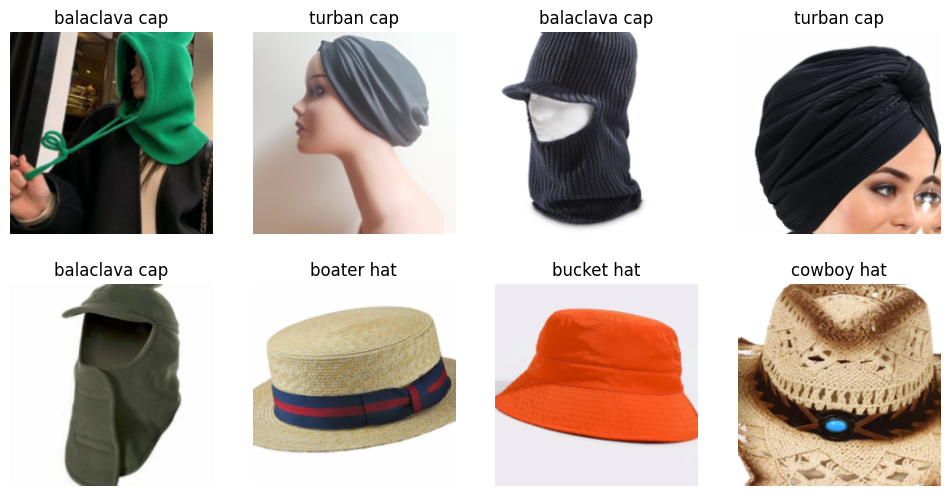

In [ ]:
dls.train.show_batch(max_n=8, nrows=2)

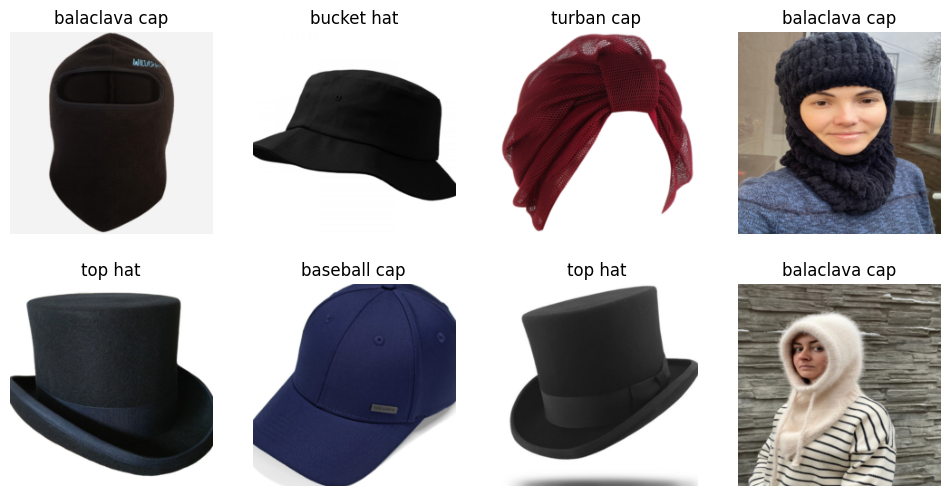

In [ ]:
dls.valid.show_batch(max_n=8, nrows=2)

# Training and Data Cleaning

In [ ]:
model_path = "models"

for more models, visit

https://timm.fast.ai/

https://docs.fast.ai/vision.learner.html

In [ ]:
model = vision_learner(dls, resnet34, metrics=[error_rate, accuracy])

Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth


100%|██████████| 83.3M/83.3M [00:00<00:00, 189MB/s]


In [ ]:
model.fine_tune(10)

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,2.286750,0.431549,0.126984,0.873016,07:21


/usr/local/lib/python3.12/dist-packages/PIL/Image.py:1047: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/PIL/Image.py:1047: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.901905,0.263367,0.079365,0.920635,00:54
1,0.618489,0.160100,0.047619,0.952381,00:50
2,0.464025,0.142518,0.031746,0.968254,00:50
3,0.354311,0.187377,0.023810,0.976190,00:50
4,0.273593,0.195704,0.055556,0.944444,00:49
5,0.213300,0.133192,0.039683,0.960317,00:50
6,0.158526,0.118106,0.023810,0.976190,00:49
7,0.122587,0.115284,0.031746,0.968254,00:57
8,0.097097,0.127578,0.039683,0.960317,00:51
9,0.081456,0.127281,0.039683,0.960317,00:48


/usr/local/lib/python3.12/dist-packages/PIL/Image.py:1047: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/PIL/Image.py:1047: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/PIL/Image.py:1047: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/PIL/Image.py:1047: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/PIL/Image.py:1047: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/PIL/Image.py:1047: UserWarning: Palette images with Transparency expressed in by

In [ ]:
doc(model.save)

Learner.save(file, *, with_opt=True, pickle_protocol=2)
Save model and optimizer state (if `with_opt`) to `self.path/self.model_dir/file`

To get a prettier result with hyperlinks to source code and documentation, install nbdev: pip install nbdev


Learner.save()

- Purpose: Save a checkpoint during training so you can resume later.
- What it saves:
    - Only the model’s weights (and optionally the optimizer state).
    - Does NOT save your DataLoaders, transforms, or other Learner settings.
- File format: .pth (PyTorch checkpoint).
- Typical use case:
    - Mid‑training savepoints.
    - Resuming training without redefining your DataLoaders and Learner.
- How to use:
    - learn.save('stage-1')  # saves to models/stage-1.pth
    - learn.load('stage-1')  # reloads weights into the same Learner


In [ ]:
# model is saved on models folder that was declared earlier
# model.save(f"cap-recognizer-v{version}")


# model.save(f"{model_path}/cap-recognizer-v{version}")

In [ ]:
# - No real format difference — PyTorch uses Python’s pickle under the hood for both .pth and .pkl.
# - The extension is just a naming convention to signal intent:
# - .pkl → “This is a generic pickled Python object.”
# - .pth → “This is a PyTorch model or checkpoint.”
# - You can technically load a .pkl file with torch.load() if it contains a PyTorch object, and vice versa.
# - For deployment, .pth is preferred in PyTorch projects for clarity.

In [ ]:
doc(model.load)

Learner.load(file, device=None, *, with_opt=True, strict=True)
Load model and optimizer state (if `with_opt`) from `self.path/self.model_dir/file` using `device`

To get a prettier result with hyperlinks to source code and documentation, install nbdev: pip install nbdev


In [ ]:
# to load model from existing file
# model.load(f"cap-recognizer-v{version}")

# model.load(f"{model_path}/cap-recognizer-v{version}")

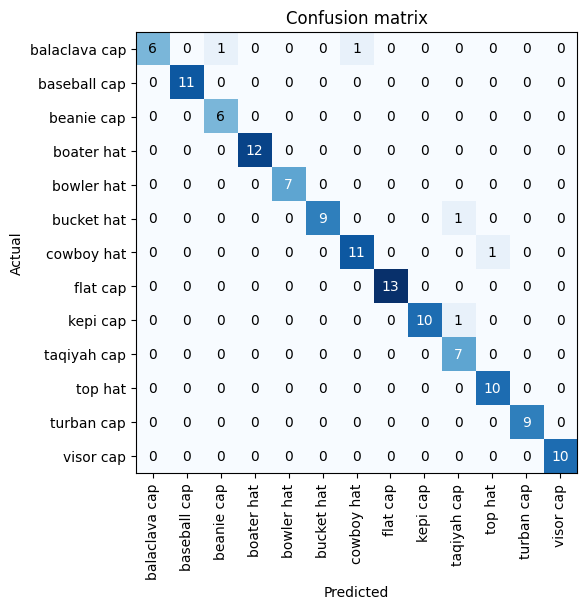

In [ ]:
# diagonal row indicates how many prediction is correct
interp = ClassificationInterpretation.from_learner(model)
interp.plot_confusion_matrix(figsize=(8, 6))

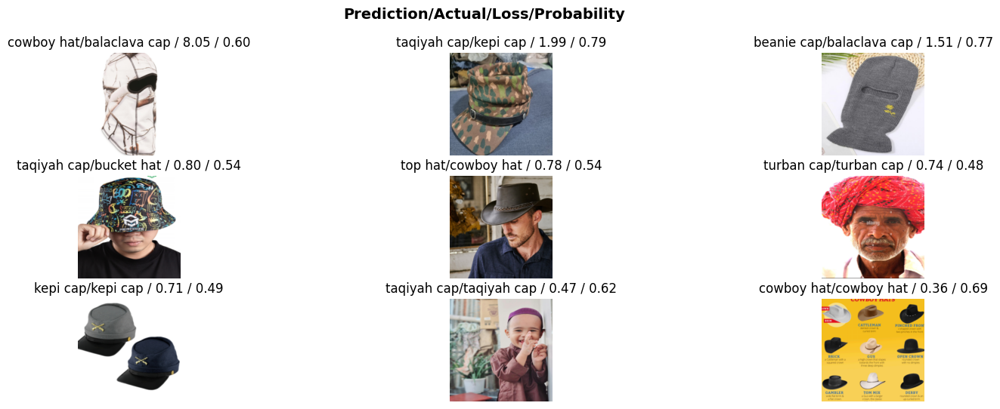

In [ ]:
# here if loss is high, then prediction is wrong
interp.plot_top_losses(9, nrows=3, figsize=(18, 6))

In [ ]:
# ImageClassifierCleaner from FastAI is a super handy tool
# for visually inspecting and cleaning mislabeled or low-confidence predictions from image classification model
# delete or relabel images directly from the widget
# after deleting data from train or valid, don't open it again, otherwise it will break
# so check train for all category then check for all valid

cleaner = ImageClassifierCleaner(model)
cleaner

/usr/local/lib/python3.12/dist-packages/PIL/Image.py:1047: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/PIL/Image.py:1047: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


/usr/local/lib/python3.12/dist-packages/PIL/Image.py:1047: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


In [ ]:
# after change or delete of data for any category in widgets, run following code block to make the changes in the main directory also
for idx in cleaner.delete(): cleaner.fns[idx].unlink()                                    # delete irrelevant data, goes to trash

# change the directory

# for idx,cat in cleaner.change(): shutil.move(str(cleaner.fns[idx]), f"{data_path}/{cat}")
import os, shutil, re

for idx, cat in cleaner.change():
    src = str(cleaner.fns[idx])
    dest_folder = os.path.join(data_path, cat)
    os.makedirs(dest_folder, exist_ok=True)

    # Find the highest number in existing files
    max_num = 0
    pattern = re.compile(r"^img_(\d+)\.[^.]+$")  # matches img_###.ext

    for fname in os.listdir(dest_folder):
        match = pattern.match(fname)
        if match:
            num = int(match.group(1))
            if num > max_num:
                max_num = num

    # New file number = highest + 1
    new_num = max_num + 1
    ext = os.path.splitext(src)[1]  # keep original extension
    new_name = f"Image_{new_num}{ext}"
    dest_path = os.path.join(dest_folder, new_name)

    shutil.move(src, dest_path)
    print(f"Moved {src} → {dest_path}")

Moved dataset/balaclava cap/Image_74.jpg → dataset/beanie cap/img_1.jpg


In [ ]:
# after cleaning
# showing total file counts for each category
# Path to main data folder
data_folder = '/content/drive/MyDrive/2025_ALL_Master_Course_Works/ALL_DL_CV/CV-Project-1_Cap-Recognizer/dataset'

# Dictionary to store file counts
file_counts = {}

# Loop through each item in the data folder
for subfolder in os.listdir(data_folder):
    subfolder_path = os.path.join(data_folder, subfolder)

    # Check if it's a directory
    if os.path.isdir(subfolder_path):
        # Count only files (not subdirectories)
        files = [f for f in os.listdir(subfolder_path) if os.path.isfile(os.path.join(subfolder_path, f))]
        file_counts[subfolder] = len(files)

# Display the results
for category, count in file_counts.items():
    print(f"{category}: {count} files")

# previous results before cleaning

# balaclava cap: 100 files
# baseball cap: 100 files
# beanie cap: 100 files
# boater hat: 100 files
# bowler hat: 100 files
# bucket hat: 100 files
# cowboy hat: 100 files
# flat cap: 100 files
# kepi cap: 100 files
# taqiyah cap: 100 files
# top hat: 100 files
# turban cap: 100 files
# visor cap: 100 files

balaclava cap: 96 files
baseball cap: 100 files
beanie cap: 101 files
boater hat: 100 files
bowler hat: 100 files
bucket hat: 100 files
cowboy hat: 100 files
flat cap: 100 files
kepi cap: 100 files
taqiyah cap: 100 files
top hat: 100 files
turban cap: 100 files
visor cap: 100 files


can train the model after cleaning model data

In [ ]:
# model.fine_tune(1)

# Export model for inference

Learner.export()
- Purpose: Save the entire Learner for inference/deployment.
- What it saves:
	- Model architecture and weights.
	- DataLoaders (including vocab, transforms, normalization stats).
	- Loss function, metrics, and most callbacks.
- File format: .pkl (Pickled Python object).
- Typical use case:
	- Deploying a trained model without needing the original training code or DataBlock.
	- Loading in a fresh environment for inference only.
- How to use:
	- learn.export('cap_recognizer.pkl')
	- from fastai.learner import load_learner
	- learn_inf = load_learner('cap_recognizer.pkl')
	- learn_inf.predict('test_image.jpg')

In [ ]:
# model.export(f"{model_path}/cap-recognizer-v{version}.pkl")